<a href="https://colab.research.google.com/github/leon-czarlinski/DivvyBikes/blob/main/divvy_bikes_eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exploratory Data Analysis (EDA) for the Chicago Divvy Bikes dataset

This hands-on project aims to explore the data set for the Chicago Divvy Bikes. This is a capstone project for the Google Data Analytics Certificate. I am working as a fictional company focused on answering key business questions, following the steps of the data analysis process: **ask, prepare, process, analyse, share**, and **act**.

The data I have in hand consists with unique trips starting January, 2022 to December, 2022. Customers who purchase single-ride or full-day passes are referred to as casual riders. Customers who purchase annual memberships are Divvy members.

> There are 13 columns containing data to be explored: 'ride_id', 'rideable_type', 'started_at', 'ended_at', 'start_station_name', 'start_station_id', 'end_station_name', 'end_station_id', 'start_lat', 'start_lng', 'end_lat', 'end_lng', 'member_casual'

Think of this project from a company perspective. The board of marketing believes the company's future success depends on maximizing the number of annual memberships. Therefore, the main objective of this case study is to understand how casual riders and annual members use Chicago's Divvy Bike program differently.

[Related article about this project](https://medium.com/@leon-czarlinski/exploratory-data-analysis-eda-of-the-chicago-divvy-bikes-dataset-bba16fea7f32)

[Code also available in Kaggle](https://www.kaggle.com/code/leonczarlinski/divvy-bikes-eda)


# Task 1: Understand the problem statement
This would be consider the **ASK** phase of the data analysis process. Asking **SMART and effective** questions help structure how to think, summarize the data, and putting things into context. The problem statement that I wrote for this project consists in 1 question:
* How do annual members and casual riders use Divvy bikes differently during the year?

The **business statement** for this task will be: Determine usage patterns between annual members and casual riders of Divvy Bikes.

# Task 2: Import libraries and dataset

This is considered the prepare phase, where I am going to import some libraries, such as pandas (used for data frame manipulation), and numpy (used for numerical analysis).

The data is located at kaggle and using the code below, we are going to import the file paths and transform into a Data Frame. The data was downloaded from the Divvy Bikes website and uploaded here, without any transformation. The data is structured, with 13 columns and each line represents a unique bike ride, identified by the ride_id column. There is no personal information and the data ROCCC, meaning that is Reliable, Original, Comprehensive, Current, and Cited.

Applying the code below, I get a list of documents contained in this directory. Each month is divided in a different file, so I am going to concatenate everything in one single data frame (df).

In [ ]:
import datetime
import calendar
import collections

import numpy as np
import pandas as pd

import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

import seaborn as sns
import networkx as nx

from operator import itemgetter


import warnings
warnings.filterwarnings("ignore")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/Colab Notebooks/DivvyBikes/data

/content/drive/MyDrive/Colab Notebooks/DivvyBikes/data


In [ ]:
import os
data_frames = []


for filename in os.listdir():
    if filename.endswith('.csv'):
        filepath = os.path.join(filename)
        df = pd.read_csv(filepath)
        data_frames.append(df)

df = pd.concat(data_frames, ignore_index=True)

In [ ]:
df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,C2F7DD78E82EC875,electric_bike,2022-01-13 11:59:47,2022-01-13 12:02:44,Glenwood Ave & Touhy Ave,525,Clark St & Touhy Ave,RP-007,42.012800,-87.665906,42.012560,-87.674367,casual
1,A6CF8980A652D272,electric_bike,2022-01-10 08:41:56,2022-01-10 08:46:17,Glenwood Ave & Touhy Ave,525,Clark St & Touhy Ave,RP-007,42.012763,-87.665967,42.012560,-87.674367,casual
2,BD0F91DFF741C66D,classic_bike,2022-01-25 04:53:40,2022-01-25 04:58:01,Sheffield Ave & Fullerton Ave,TA1306000016,Greenview Ave & Fullerton Ave,TA1307000001,41.925602,-87.653708,41.925330,-87.665800,member
3,CBB80ED419105406,classic_bike,2022-01-04 00:18:04,2022-01-04 00:33:00,Clark St & Bryn Mawr Ave,KA1504000151,Paulina St & Montrose Ave,TA1309000021,41.983593,-87.669154,41.961507,-87.671387,casual
4,DDC963BFDDA51EEA,classic_bike,2022-01-20 01:31:10,2022-01-20 01:37:12,Michigan Ave & Jackson Blvd,TA1309000002,State St & Randolph St,TA1305000029,41.877850,-87.624080,41.884621,-87.627834,member
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5667712,211BE0DC162D85B7,electric_bike,2022-02-23 17:47:49,2022-02-23 18:02:29,NaN,NaN,Leavitt St & Chicago Ave,18058,41.880000,-87.630000,41.895501,-87.682017,member
5667713,D4D53E78000C8CA1,electric_bike,2022-02-04 10:43:47,2022-02-04 10:50:52,NaN,NaN,Leavitt St & Chicago Ave,18058,41.910000,-87.680000,41.895501,-87.682017,member
5667714,9E85F07D2F94492B,electric_bike,2022-02-28 09:16:33,2022-02-28 09:28:11,Wood St & Chicago Ave,637,Canal St & Adams St,13011,41.895714,-87.672210,41.879255,-87.639904,member
5667715,B61B559F81F1D823,electric_bike,2022-02-10 16:55:16,2022-02-10 16:57:53,NaN,NaN,Canal St & Adams St,13011,41.880000,-87.630000,41.879255,-87.639904,member


# Task 3: Process the data

Before analyzing the data, I need to **process** it by checking for errors, null values, and/or outliers. Basically I am going to do some checks about the data frame to see if there are some information we need to be aware, before working with it. The process phase is important to connect business objectives to data analysis, clean the dataset and document the data-cleaning process.

Let's first use the method .columns to see how many columns are in the df.

In [15]:
df.columns

Index(['ride_id', 'rideable_type', 'started_at', 'ended_at',
       'start_station_name', 'start_station_id', 'end_station_name',
       'end_station_id', 'start_lat', 'start_lng', 'end_lat', 'end_lng',
       'member_casual', 'started_day', 'started_month', 'ended_day',
       'ended_month', 'ride_length', 'distance_km'],
      dtype='object')

By using the method **info()**, it is possible to check the data type for each column.



In [16]:
# Check the Data type info for each column
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4132921 entries, 0 to 5667714
Data columns (total 19 columns):
 #   Column              Dtype         
---  ------              -----         
 0   ride_id             object        
 1   rideable_type       object        
 2   started_at          datetime64[ns]
 3   ended_at            datetime64[ns]
 4   start_station_name  object        
 5   start_station_id    object        
 6   end_station_name    object        
 7   end_station_id      object        
 8   start_lat           float64       
 9   start_lng           float64       
 10  end_lat             float64       
 11  end_lng             float64       
 12  member_casual       object        
 13  started_day         int64         
 14  started_month       int64         
 15  ended_day           int64         
 16  ended_month         int64         
 17  ride_length         float64       
 18  distance_km         float64       
dtypes: datetime64[ns](2), float64(6), int64(4)

## Change date columns to the date time format

The columns started_at and ended_at are recognized as objects, so I am going to change it to date time. Also, I will add 4 new columns in the data frame: started_day, started_month, ended_day, and ended_month. By dividing the info in smaller pieces, it will be possible to build different analysis, as you will see below.

In [ ]:
# Change the columns to datetime
df['started_at'] = pd.to_datetime(df['started_at'])
df['ended_at'] = pd.to_datetime(df['ended_at'])

df['started_day'] = df['started_at'].dt.day
df['started_month'] = df['started_at'].dt.month

df['ended_day'] = df['ended_at'].dt.day
df['ended_month'] = df['ended_at'].dt.month

## Add distance and length columns

The df has information about date time, latitude and longitute for the start and end of each trip. I will calculate the length based in the ended_at and started_at columns. The length of the ride will be stored in a new colum called **ride_length**, in minutes. I am going to subtract ended_at from started_at and divide by 60. Using the sample() method, I am printing 5 samples out of the df.

In [ ]:
df['ride_length'] = (df['ended_at'] - df['started_at']).dt.total_seconds()/60
df['ride_length'].sample(6)

357728     16.683333
112569      7.500000
5008557    10.033333
1248984    36.583333
2684261     1.500000
3102742    14.400000
Name: ride_length, dtype: float64

To calculate the ride distance in km and store in a new column called **distance_km**, I am using the Haversine formula. For this calculation, I am using the start_lng, start_lat, end_lng, and end_lat columns and import haversine from python.

This will generate an approximate distance in kilometers that each trips has. It is approximate distance, because users could take different paths,and take different lengths to reach the same point. I am calculating the distance between the starting station and ending station, but the purpose is to have one more feature that I could analyse and transform into valuable information.

In [ ]:
%pip install haversine

In [ ]:
from haversine import haversine, Unit

def calculate_distance(row):
    loc1 = (row['start_lat'], row['start_lng'])
    loc2 = (row['end_lat'], row['end_lng'])
    return haversine(loc1, loc2, unit=Unit.KILOMETERS)

df['distance_km'] = df.apply(calculate_distance, axis=1)
df['distance_km'].sample(6)

2101240    3.391201
524323     0.000000
5209641    0.762448
1127565    0.649941
2061340    3.368011
918167     2.979331
Name: distance_km, dtype: float64

## Identify null values and outliers

The df has null values and also outliers that won't make sense for our analysis. Some points that we can consider:

* The null values can be substituted by mean values or deleted. In this case, I am deleting it
* There might be outliers in the trip length and trip distance features. I am going to delete those outliers

Let's start by checking null values, and drop them by using the method dropna()

In [17]:
# Check for null values
df.isnull().sum()

ride_id               0
rideable_type         0
started_at            0
ended_at              0
start_station_name    0
start_station_id      0
end_station_name      0
end_station_id        0
start_lat             0
start_lng             0
end_lat               0
end_lng               0
member_casual         0
started_day           0
started_month         0
ended_day             0
ended_month           0
ride_length           0
distance_km           0
dtype: int64

In [ ]:
df.dropna(axis=0, inplace=True)

Now, I will use the method **describe()** to have an ideia of min and max values for length and distance.

My assumptions about length:

* Trips longer than 180 min are outliers and make no sense to keep in the data frame.
* Trips with negative length are also outliers and might be a mistake in the df. So I am deleting it.

My assumptions about distance:

* Trips with a distance greater than 10 km are outliers and make no sense.
* Trips with negative distance are also outliers and must be deleted.

In [18]:
pd.set_option('display.float_format', lambda x: '%.2f' % x)
df[['ride_length','distance_km']].describe()

,ride_length,distance_km
count,4132921.00,4132921.00
mean,15.12,2.13
std,16.12,1.68
min,0.02,0.00
25%,6.10,0.97
50%,10.45,1.62
75%,18.17,2.79
max,179.98,10.00


In [ ]:
df.drop(df[(df['ride_length'] >= 180) | (df['ride_length'] <= 0)].index, inplace=True)
df.drop(df[(df['distance_km'] >= 10) | (df['distance_km'] <= 0)].index, inplace=True)

Finally, I am printing a final count of values to see how many trips I have left to work with.

In [19]:
#Check the final count of number of trips
df.count()

ride_id               4132921
rideable_type         4132921
started_at            4132921
ended_at              4132921
start_station_name    4132921
start_station_id      4132921
end_station_name      4132921
end_station_id        4132921
start_lat             4132921
start_lng             4132921
end_lat               4132921
end_lng               4132921
member_casual         4132921
started_day           4132921
started_month         4132921
ended_day             4132921
ended_month           4132921
ride_length           4132921
distance_km           4132921
dtype: int64

By deleting the null values and outliers, the number of lines dropped 27% out of the total during the process phase, which I am not considering a great loss, since we have a df with millions of information.

In the year of 2022 there was 5.6 mio trips, but after processing the data, the analysis will be build using 4.1 mio trips

In [ ]:
df.head(10)

,ride_id,rideable_type,started_at,ended_at,start_station_name,...,started_month,ended_day,ended_month,ride_length,distance_km
0,C2F7DD78E82EC875,electric_bike,2022-01-13 11:59:47,2022-01-13 12:02:44,Glenwood Ave & Touhy Ave,...,1,13,1,2.950000,0.699548
1,A6CF8980A652D272,electric_bike,2022-01-10 08:41:56,2022-01-10 08:46:17,Glenwood Ave & Touhy Ave,...,1,10,1,4.350000,0.694323
2,BD0F91DFF741C66D,classic_bike,2022-01-25 04:53:40,2022-01-25 04:58:01,Sheffield Ave & Fullerton Ave,...,1,25,1,4.350000,1.000834
3,CBB80ED419105406,classic_bike,2022-01-04 00:18:04,2022-01-04 00:33:00,Clark St & Bryn Mawr Ave,...,1,4,1,14.933333,2.462783
4,DDC963BFDDA51EEA,classic_bike,2022-01-20 01:31:10,2022-01-20 01:37:12,Michigan Ave & Jackson Blvd,...,1,20,1,6.033333,0.814539
5,A39C6F6CC0586C0B,classic_bike,2022-01-11 18:48:09,2022-01-11 18:51:31,Wood St & Chicago Ave,...,1,11,1,3.366667,0.846503
6,BDC4AB637EDF981B,classic_bike,2022-01-30 18:32:52,2022-01-30 18:49:26,Oakley Ave & Irving Park Rd,...,1,30,1,16.566667,2.988864
7,81751A3186E59A6B,classic_bike,2022-01-22 12:20:02,2022-01-22 12:32:06,Sheffield Ave & Fullerton Ave,...,1,22,1,12.066667,2.118017
8,154222B86A338ABD,electric_bike,2022-01-17 07:34:41,2022-01-17 08:00:08,Racine Ave & 15th St,...,1,17,1,25.450000,2.768709
9,72DC25B2DD467EEF,classic_bike,2022-01-28 15:27:53,2022-01-28 15:35:16,LaSalle St & Jackson Blvd,...,1,28,1,7.383333,0.959915


# Task 4: Perform exploratory data analysis
Now that I have imported the data set, defined the dataframe, imported libraries and checked the data, I achieved the prepare and process the data phase. Now I can go on and **analyze** the data and build some visualization to get some insights.

Let's put in perspective the problem statement, so I don't loose track during analysis. The **business statement** is: Determine usage patterns between annual members and casual riders of Divvy Bikes.

I am going to use the plotly.express for data analysis and visualization.


In [20]:
import plotly.express as px

## What is the preferred rideable type?

Users can either choose between eletric or normal bikes. Let's explore the proportion of the type of bikes that were used considering all trips that hapenned in 2022.

In [28]:
count_rideable_type = df['rideable_type'].value_counts().reset_index()
count_rideable_type.columns = ['rideable_type', 'count']
count_rideable_type

,rideable_type,count
0,classic_bike,2422415
1,electric_bike,1572835
2,docked_bike,137671


In [29]:
fig = px.pie(count_rideable_type, values='count', names='rideable_type', title='Trips by type of bike')
fig.show()

Among all trips, more than half (58.6%) were made with classic bikes. Eletric bikes represent 38.1% of all trips. It might be that the number of classic bikes available is higher compared to eletric bikes. Divvy bikes also has scooters available, but apparently the data is not available in this data set.

## Proportion of trips by user type
There are two types of user:

* Customers who purchase single-ride or full-day passes are referred to as casual riders.
* Customers who purchase annual memberships are Divvy members

Let's see the proportion of trips by each type of user

In [32]:
count_member_type = df['member_casual'].value_counts().reset_index()
count_member_type.columns = ['member_casual', 'count']
fig = px.pie(count_member_type, values='count', names='member_casual', title='Trips by type of user')
fig.show()

Divvy members are responsible for 61% of all trips during the year of 2022. Casual riders are responsible for the remaining 39% of all trips. Doing some research in the internet, I have learned that in 2022 Divvy had nearly 550,000 unique riders and 43,000 members. With this numbers in mind, we can say that each casual rider did 2.9 rides in 2022, whereas members did almost 57 trips each. That's almost 20 x more compared to casual riders.

[Source](https://www.chicago.gov/city/en/depts/cdot/provdrs/bike/news/2023/april/divvy-for-the-entire-city--divvy-service-hits-all-50-wards.html#:~:text=Since%202020%2C%20the%20number%20of,over%2015%2C000%20bikes%20and%20scooters)

In [33]:
avg_ride_lenght = df.groupby('member_casual')['ride_length'].mean().reset_index()
fig = px.bar(avg_ride_lenght, x='member_casual', y='ride_length', title='Average ride length (in min) for each type of user')
fig.show()

The length of the trips for casual riders is almost the double for members. This might explain a little bit of the purpose of each type of user for the program. Casual riders might be enjoying a vacation, or are riding during the weekend, whereas members might be using to move around the city, to get to places, like their work , school, appointment, etc.

In [34]:
avg_distance = df.groupby('member_casual')['distance_km'].mean().reset_index()
fig = px.bar(avg_distance, x='member_casual', y='distance_km', title='Average distance (in km) for each type of user')
fig.show()

When it comes to distance, we can see that casual riders and member ride almost the same distance. It is only a 10% difference. Since, I am using an approximate distance, it is possible to conclude that casual riders actually travel longer distances, by taking a bigger path between stations. Or it is possible to conclude that casual riders are much slower than members, maybe, because they are riding and sightseeing.

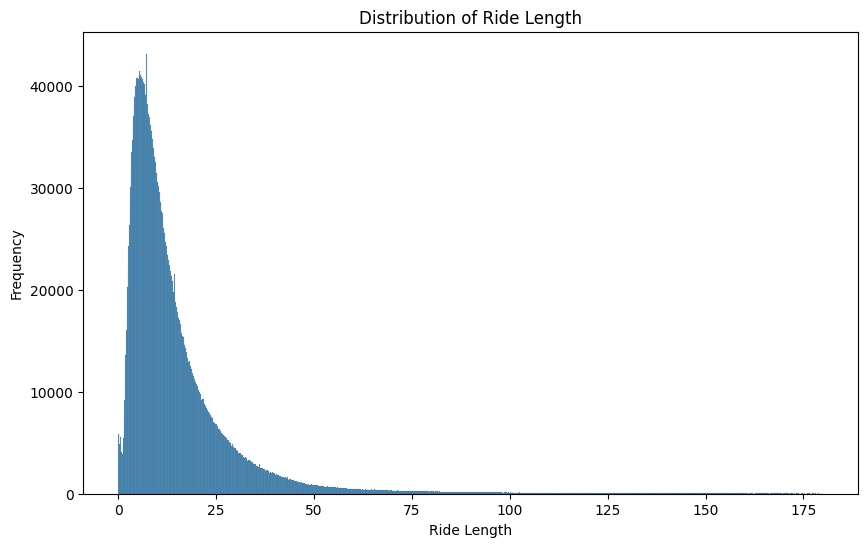

In [37]:
# Create the histogram
plt.figure(figsize=(10, 6))
sns.histplot(df['ride_length'], kde=False)

# Customizing the plot
plt.title('Distribution of ride Length (in min)')
plt.xlabel('Ride Length')
plt.ylabel('Frequency')

# Show the plot
plt.show()

The graph above the vast majority of rides are shorter than 20 minutes. However it is possible to see that some users ended up exceeding the limit and ride for up to 2 hours.

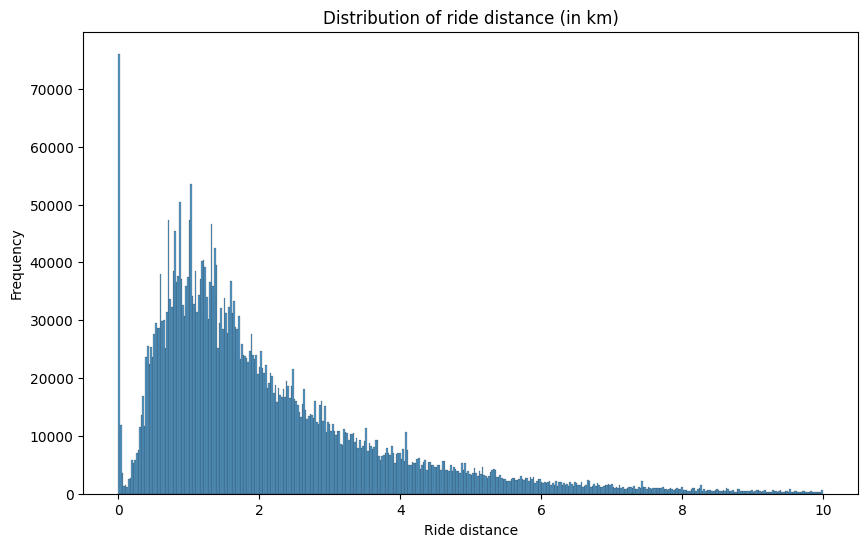

In [38]:
# Create the histogram
plt.figure(figsize=(10, 6))
sns.histplot(df['distance_km'], kde=False)

# Customizing the plot
plt.title('Distribution of ride distance (in km)')
plt.xlabel('Ride distance')
plt.ylabel('Frequency')

# Show the plot
plt.show()

When it comes to distance, the distribution is spreader and there are some peaks. This might indicate a multimodal distribution, which is shows profile for several different subpopulations.

In [39]:
fig = px.histogram(df, x="started_day", title='Number of trips by Day of the Month', color='member_casual', labels={'started_day': 'Day of the Month'}, text_auto=True, nbins=31)
fig.show()

The graph above tries to identify if there is any day of the month that might have more rides than usual, but it seems to be pretty constant. Also, for each type of user, the graph seems to follow the same pattern.

In [40]:
fig = px.histogram(df, x="started_month", title='Number of trips by month', color='member_casual', labels={'started_month': 'Month'}, text_auto=True, nbins=12)
fig.show()

When it comes to a distribution by month of the year, we can see a clear peak during end of spring and beggining of fall, with the highest peak during the summer. It is possible to see that between members, the distribution is smoother, compared to casual users. That might be aplained by the subscription type. By doing some research in the internet, in Chicago, July is the hottest month with an average temperature of 23°C (73°F) and the coldest is January at -6°C (21°F) with the most daily sunshine hours at 12 in July. The graph above shows that July has 8 times more rides compared to january. There might be a huge correlation between temperature and divvy usage.

In [41]:
# Calculate the average ride time per day for each member_casual type
avg_ride_time_per_day = df.groupby([df['started_at'].dt.date, 'member_casual'])['ride_length'].mean().reset_index()

# Create the line chart
fig = px.line(avg_ride_time_per_day, x='started_at', y='ride_length',
              line_group='member_casual', color='member_casual',
              title='Average Ride Time by Day for Members and Casual Riders',
              labels={'started_at': 'Date', 'avg_ride_time_per_day': 'Average Ride Time (in min)'})

# Show the figure
fig.show()

When it comes to average ride time, there is no clear pattern for longer rides in a specific time of the year. The only correlation that might be, is that the average time peaks from members, follow the peaks from casual riders.

In [42]:
# Calculate the average ride distance per day for each member_casual type
avg_ride_distance_per_day = df.groupby([df['started_at'].dt.date, 'member_casual'])['distance_km'].mean().reset_index()

# Create the line chart
fig = px.line(avg_ride_distance_per_day, x='started_at', y='distance_km',
              line_group='member_casual', color='member_casual',
              title='Average Ride distance by Day for Members and Casual Riders',
              labels={'started_at': 'Date', 'avg_ride_distance_per_day': 'Average Ride distance (km)'})

# Show the figure
fig.show()

When it comes to average distance per day, there is also low correlation between longer distances and time of the year. It is posible to see a small curvature towards the hottest days, but is not conclusive. This graph also shows a high amount of peaks, making it hard to find patterns.

## Where do the most rides start?

I am going to explore a little bit about where most of the rides start, by plotting the count, by latitude and logitude. We will see the map of Chicago build by a bunch of dots, which is quite cool and it is possible to see that most of the rides start closest to the city downtown, where the first stations were build back in 2013.

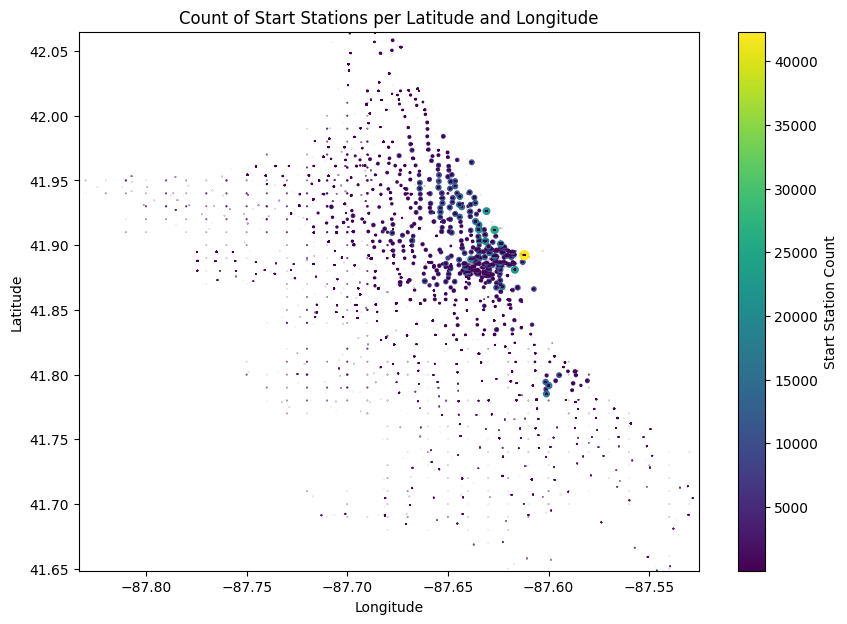

In [43]:
# Group by latitude and longitude and count the start_station_name occurrences
ride_counts = df.groupby(['start_lat', 'start_lng'])['start_station_name'].count().reset_index()

start_lng_min = df['start_lng'].min()
start_lng_max = df['start_lng'].max()
start_lat_min = df['start_lat'].min()
start_lat_max = df['start_lat'].max()

plt.figure(figsize=(10, 7))

# Plot the count of start_station_name
plt.scatter(ride_counts['start_lng'], ride_counts['start_lat'],
            s=ride_counts['start_station_name']/1000,
            c=ride_counts['start_station_name'])

plt.xlim(start_lng_min, start_lng_max)  # Set the limits for longitude to focus on Chicago
plt.ylim(start_lat_min, start_lat_max)  # Set the limits for latitude to focus on Chicago

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Start Station Count')
plt.title('Count of Start Stations per Latitude and Longitude')
plt.show()

In [44]:
top_stations = df.groupby('start_station_name')['ride_id'].count().reset_index()
top_stations = top_stations.sort_values(by='ride_id', ascending=False).head(25)

fig = px.bar(top_stations, x='start_station_name', y='ride_id', title='Top 25 stations - started rides')
fig.show()

Streeter Dr. & Grand Ave. is near a very popular pier in Chicago and a Museum. People use the bikes for fun and to get to and between points of interest. Lake Shore Dr. & North Blvd. is near Grant Park which is a great place to go bike riding.

## Creating the Graph object

The last part of the analysis is based in the study developed by GEOMETREIN in a work using the Helsinki City Bikes dataset. To access the original work by Geometrein, CLICK HERE.

My intention was to create the Graph object using NetworkX. The graph represents a network of bike stations and their connections based on bike rides. In this graph, each node represents a bike station, and each edge (connection between nodes) symbolizes a bike ride from one station to another.

The coordinates of each station are obtained from a CSV file that I build separately. The size of each node in the graph is determined by the frequency of departures from that station, giving a visual indication of the station's usage. The top stations are the same represented in the bar graph above, where I listed the most popular stations. Meaning, the more frequent the departures, the larger the node.

The edges are styled as dotted lines to illustrate the connections between stations.

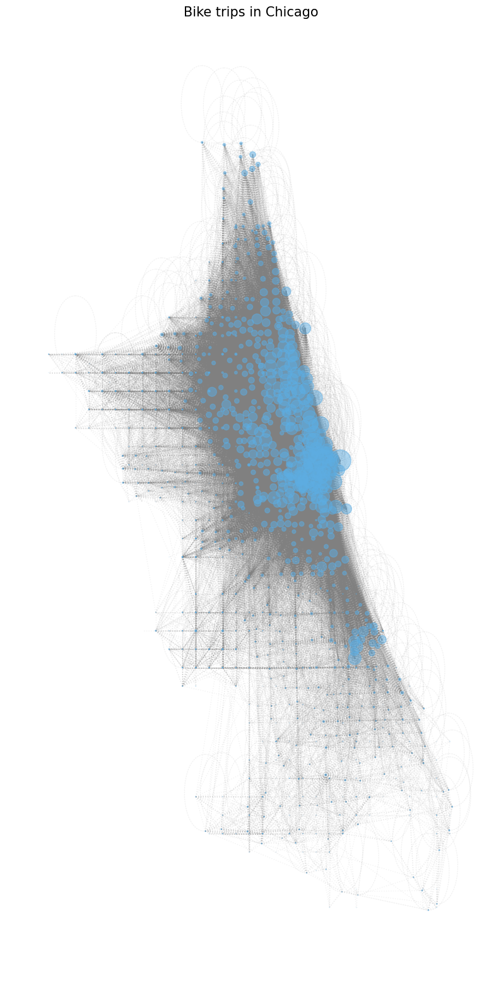

In [45]:
import networkx as nx

# Create the graph from the DataFrame
G = nx.from_pandas_edgelist(df, 'start_station_name', 'end_station_name', edge_attr=['ride_length','distance_km'])

# Prepare the station coordinates
stations = pd.read_csv('https://raw.githubusercontent.com/leon-czarlinski/DivvyBikes/main/station_coordinates.csv')
stations.set_index('station_name', inplace=True)
stations["pos"] = list(zip(stations['lng'].astype(float), stations['lat'].astype(float)))
positions = stations.to_dict()['pos']

# Calculate node sizes
node_size_map = df['start_station_name'].value_counts().to_dict()
node_sizes = [node_size_map.get(node, 0) / 100 for node in G.nodes()]

# Draw the graph
fig, ax = plt.subplots(figsize=(10,20))
nx.draw_networkx_nodes(G=G, pos=positions, node_color='#5DADE2', alpha=0.5, node_size=node_sizes)
nx.draw_networkx_edges(G=G, pos=positions, edge_color='grey', style="dotted", alpha=0.1, arrows=False)
ax.axis('off')

plt.title("Bike trips in Chicago", fontsize=15)

plt.show()

# Conclusion

In this hands-on project, my objective was to go through the steps of the data analysis process: **ask, prepare, process, analyse, share**, and **act**.

The data I analyzed consisted with unique trips starting January, 2022 to December, 2022, by two types of customers: casual riders (who purchase single-ride or full-day passes), and members (who purchase annual memberships). The objective of the EDA was to understand and determine the usage patterns by customers, trying to answer the question: **how do annual members and casual riders use Divvy bikes differently during the year?**

After preparing and processing the data, I was able to work with 4.1 mio trips, and build analysis such as preferred rideable type, proportion of rides by type of user, the length and distance by each type of customer, usage patterns by day, month and throughout the year.

Finally, I had the chance to plot and see the map of Chicago by counting the preferred starting stations by latitude and longitude, and I did a graphical representation providing an intuitive and spatial understanding of the bike network, highlighting key stations based on activity and the connectivity among different locations. The visual nature of this graph makes it easier to identify patterns, such as popular stations or commonly used routes, within the bike-sharing network.